# Using the EXBA tools

This notebook shows how to use the tools available in the EXBA class.
It uses the `lightkurve` package as base.

In [1]:
import os, sys, glob
import numpy as np
import pandas as pd
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import seaborn as sb
import lightkurve as lk
from lightkurve.correctors import CBVCorrector

%matplotlib inline
path = os.path.dirname(os.getcwd()) 

sys.path.append(path)
from exba.exba_tools_new_ap import EXBA

In [4]:
channels = [1, 12, 29,45, 61,75]
quarters = [5, 9, 12, 16]

# Explore CBV correction from `lightkurve` 

In [2]:
cbv_type = ['SingleScale']
cbv_indices = [np.arange(1,9)]

In [6]:
lcs, alpha, over_fit_m, under_fit_m, corrected_lcs = [], [], [], [], []
chq = []

for ch, q in [(ch, q) for ch in channels for q in quarters]:
    print("Ch ", ch, "Q", q)
    exba = EXBA(channel=ch, quarter=q)
    exba._build_psf_model(plot=False, load=True, show=False, fine=True)
    exba.find_all_apertures(plot=False)
    exba.metrics()
    exba.do_photometry()

    for lc in tqdm(exba.sap_lcs, desc="Applying CBVs to LCs", leave=False):
        lc = lc[lc.flux_err > 0].remove_outliers(sigma_upper=3,
                                                 sigma_lower=1e20,
                                                 cenfunc=np.median)
        try:
            cbvCorrector = CBVCorrector(lc, interpolate_cbvs=False)
            cbvCorrector.correct(cbv_type=cbv_type,
                                 cbv_indices=cbv_indices, 
                                 alpha_bounds=[5e-3, 5e3],
                                 target_over_score=0.9,
                                 target_under_score=0.8)
        except ValueError:
            print('ValueError')
            continue
        lcs.append(lc)
        chq.append([ch, q])
        alpha.append(cbvCorrector.alpha)
        over_fit_m.append(cbvCorrector.over_fitting_score)
        under_fit_m.append(cbvCorrector.under_fitting_score)
        corrected_lcs.append(cbvCorrector.corrected_lc)
        #cbvCorrector.diagnose();
        #cbvCorrector.goodness_metric_scan_plot(cbv_type=cbv_type, cbv_indices=cbv_indices);
        break
    break

Ch  1 Q 5
TargetPixelFileCollection of 4 objects:
	100002171 (1 KeplerTargetPixelFiles) Quarters: 5
	100002172 (1 KeplerTargetPixelFiles) Quarters: 5
	100002173 (1 KeplerTargetPixelFiles) Quarters: 5
	100002174 (1 KeplerTargetPixelFiles) Quarters: 5

Loading query from file...
/Users/jorgemarpa/Work/BAERI/ADAP/EXBA_pathfinder/data/EXBA/1/5/gaia_xmatch_query_result.csv


Applying CBVs to LCs:   0%|          | 0/41 [00:00<?, ?it/s]

Optimized Over-fitting metric: 0.9389673795700162
Optimized Under-fitting metric: 0.9975318108991162
Optimized Alpha: 6.108e-02


In [14]:
cbvCorrector.cbvs[0]

time,CADENCENO,VECTOR_1,VECTOR_2,VECTOR_3,VECTOR_4,VECTOR_5,VECTOR_6,VECTOR_7,VECTOR_8,VECTOR_9,VECTOR_10,VECTOR_11,VECTOR_12,VECTOR_13,VECTOR_14,VECTOR_15,VECTOR_16,GAP
,,,,,,,,,,,,,,,,,,
object,int32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,int32
443.4911549199969,16373,0.010814609937369823,-0.03696492686867714,0.03449413925409317,0.010164232924580574,-0.031984712928533554,-0.009007792919874191,6.585707160411403e-05,-0.02954881824553013,0.008538200519979,-0.052015382796525955,-0.009805283509194851,-0.0047074309550225735,-0.017385749146342278,0.014481788501143456,0.015821734443306923,0.027722325176000595,1
443.5115886200001,16374,0.010814609937369823,-0.03696492686867714,0.03449413925409317,0.010164232924580574,-0.031984712928533554,-0.009007792919874191,6.585707160411403e-05,-0.02954881824553013,0.008538200519979,-0.052015382796525955,-0.009805283509194851,-0.0047074309550225735,-0.017385749146342278,0.014481788501143456,0.015821734443306923,0.027722325176000595,0
443.5320221200018,16375,0.010860140435397625,-0.036695320159196854,0.03284269943833351,0.012971322983503342,-0.03511542081832886,-0.010476275347173214,0.004061337094753981,-0.03209219500422478,0.0008300843182951212,-0.04705587401986122,-0.0254108477383852,-0.014291723258793354,-0.003292013658210635,-0.005962385796010494,0.016550946980714798,0.02033914253115654,0
443.55245571999694,16376,0.010954990051686764,-0.03718201071023941,0.03448373079299927,0.015839146450161934,-0.0327371284365654,-0.008914553560316563,0.0019517394248396158,-0.0231154952198267,0.0030258100014179945,-0.04746633023023605,-0.02358022704720497,-0.015589369460940361,-0.011943710036575794,-0.0019085403764620423,0.011604259721934795,0.044286664575338364,0
443.57288942000014,16377,0.010983374901115894,-0.03581360727548599,0.034570254385471344,0.010906255804002285,-0.03182700648903847,-0.016581179574131966,-0.006917629390954971,-0.031024634838104248,0.0025378153659403324,-0.05016485974192619,-0.013692774809896946,-0.005351692903786898,-0.008045469410717487,0.011237015016376972,0.01926717720925808,0.045477721840143204,0
443.5933229200018,16378,0.011057788506150246,-0.03695844113826752,0.034320905804634094,0.011582695879042149,-0.028314074501395226,-0.018570812419056892,-0.005059055984020233,-0.028753474354743958,-0.005293522961437702,-0.04161612316966057,-0.011304857209324837,-0.008934777230024338,0.005241968668997288,0.004470223095268011,0.006243825424462557,0.030420687049627304,0
443.61375651999697,16379,0.011132714338600636,-0.03642067313194275,0.03424004837870598,0.01107657328248024,-0.03152700886130333,-0.017225340008735657,-0.0069018336944282055,-0.03308257460594177,-0.0037200795486569405,-0.05218547582626343,-0.01574488915503025,-0.014443795196712017,0.005249828565865755,0.009947043843567371,0.009590796194970608,0.023159794509410858,0
443.63419022000016,16380,0.011168773286044598,-0.03654235973954201,0.0320860855281353,0.00943327322602272,-0.03359261155128479,-0.01422574371099472,-0.008115585893392563,-0.027036814019083977,0.0013824503403156996,-0.044077448546886444,-0.021070657297968864,-0.009049988351762295,-0.010148264467716217,0.019456058740615845,0.017966529354453087,0.02628028765320778,0


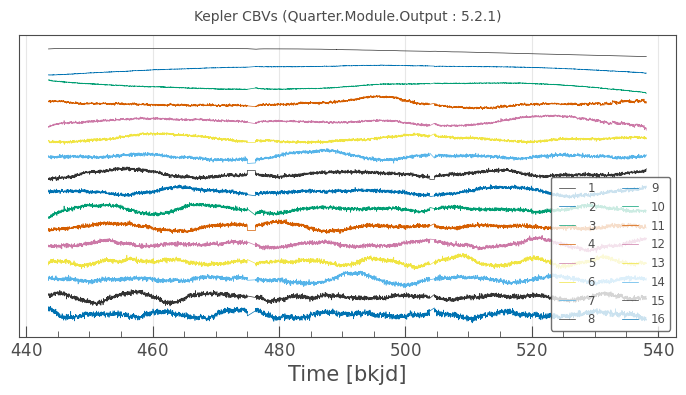

In [7]:
cbvCorrector.cbvs[0].plot();

In [ ]:
chq = np.array(chq)
lcs = lk.LightCurveCollection(lcs)
corrected_lcs = lk.LightCurveCollection(corrected_lcs)
alpha = np.array(alpha)
over_fit_m = np.array(over_fit_m)
under_fit_m = np.array(under_fit_m)

In [ ]:
df = pd.DataFrame(np.array([alpha, over_fit_m, under_fit_m, chq[:,0], chq[:,1]]).T, 
                  columns=['alpha','over','under', 'ch', 'q'], 
                  index=[lc.label for lc in lcs])
df["log_alpha"] = np.log10(df.alpha)

In [ ]:
sb.displot(data=df, x="log_alpha", hue="ch", palette='tab10', kind="kde");
sb.displot(data=df, x="log_alpha", hue="q", palette='tab10', kind="kde");

/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


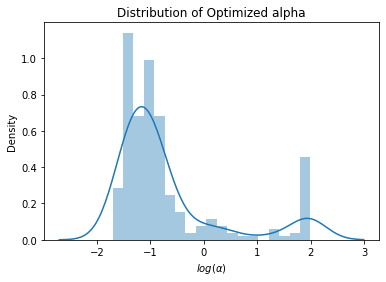

In [59]:
sb.distplot(df.log_alpha)
plt.title("Distribution of Optimized alpha")
plt.xlabel(r'$log(\alpha)$')
plt.show()

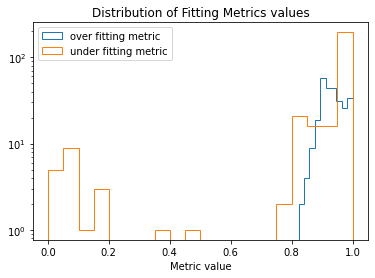

In [19]:
plt.hist(over_fit_m, histtype='step', label='over fitting metric', log=True)
plt.hist(under_fit_m, histtype='step', label='under fitting metric', bins=20, log=True)
plt.title("Distribution of Fitting Metrics values")
plt.xlabel("Metric value")
plt.legend(loc="upper left")
plt.show()

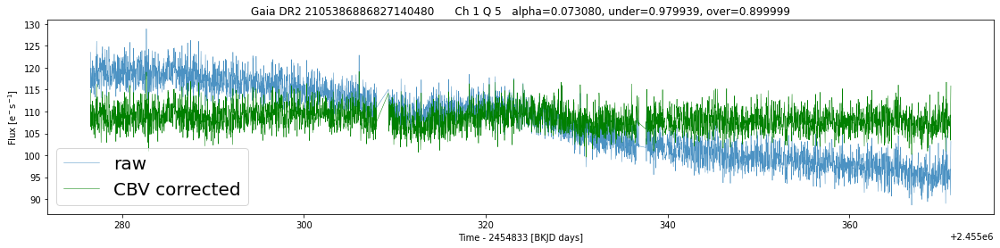

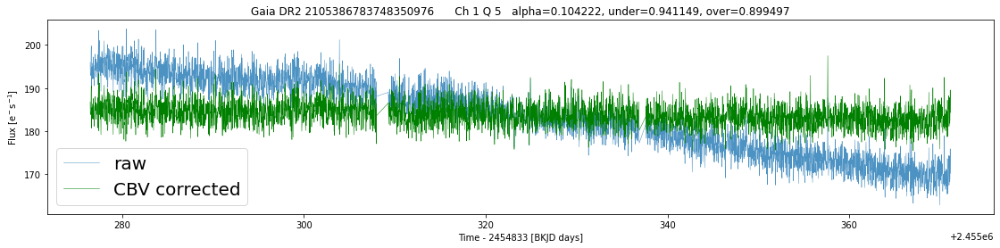

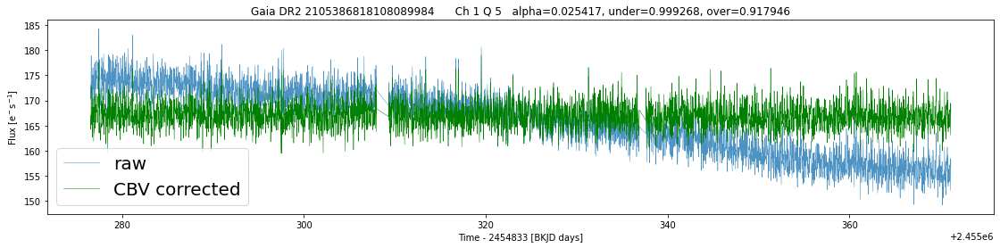

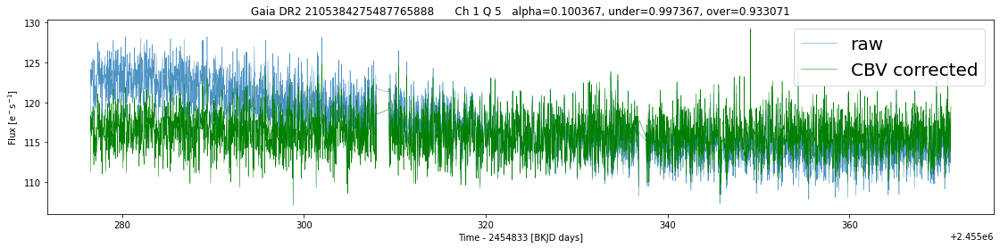

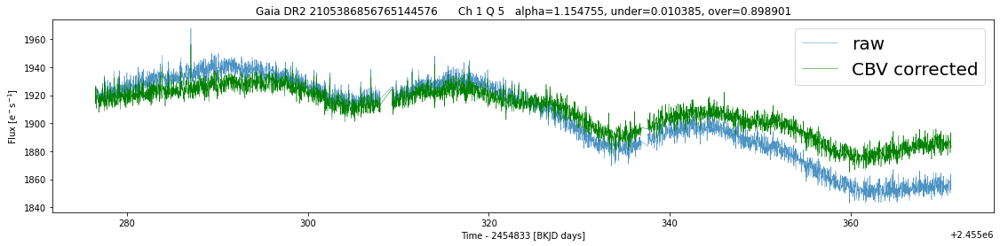

...

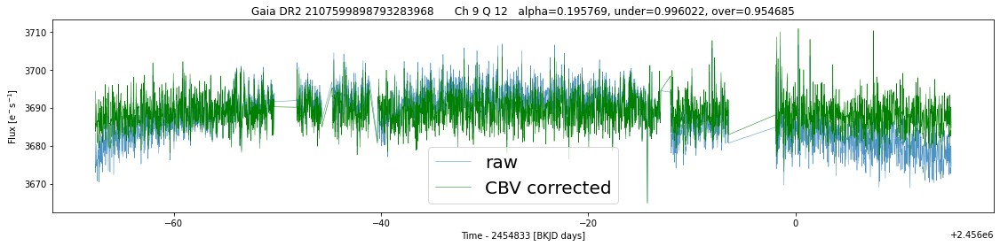

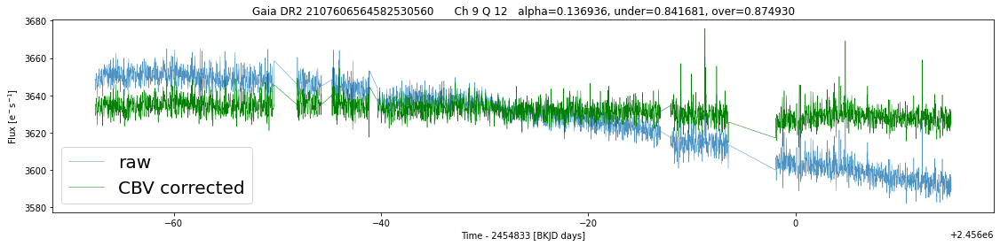

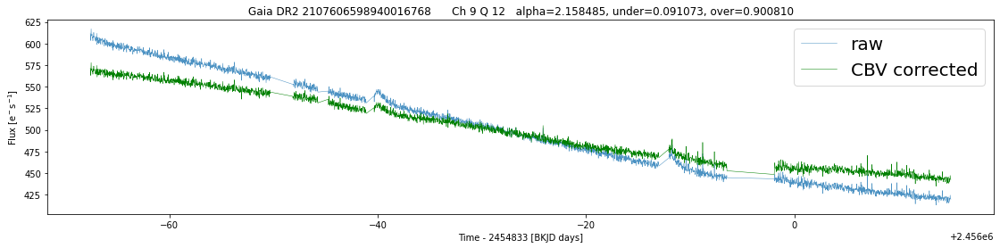

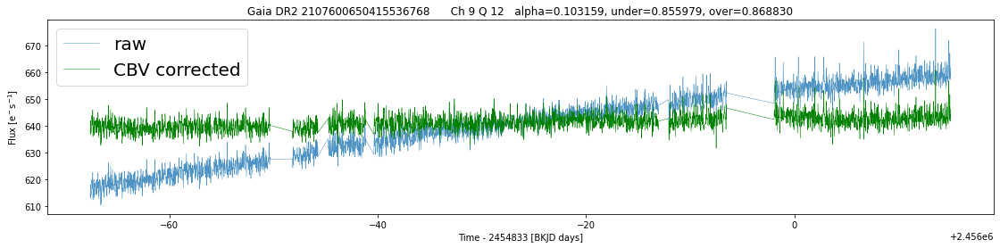

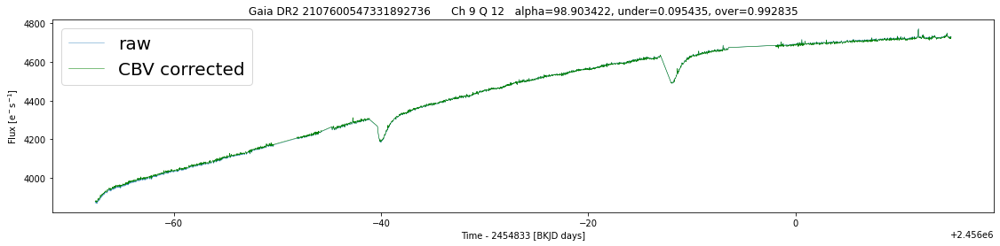

In [58]:
for i, (lc, lcc) in enumerate(zip(lcs, corrected_lcs)):
    fig, ax = plt.subplots(1, 1, figsize=(19,4))
    ax.set_title("%s      Ch %i Q %i   alpha=%f, under=%f, over=%f" % (lc.label, lc.channel, lc.quarter,
                                                         df.alpha[i], df.under[i], df.over[i]))
    lc.plot(ax=ax, label="raw", alpha=.8)
    lcc.plot(ax=ax, label="CBV corrected", c="g")
    plt.legend(fontsize=20)
    plt.show()
    #break